Frequency for planar photo emission

Kristinn Torfason 15.10.17
Update 29.04.21 by Hákon Örn Árnason


In [65]:
import numpy as np
import scipy
from scipy.fft import fft, ifft
import matplotlib.pyplot as plt
%matplotlib inline

In [66]:
time_scale = 1.0E-12
length_scale = 1.0E-9

filename = '../data/out/emitted.dt'
#filename = '../data/out/absorbed.dt'
data = np.loadtxt(filename, usecols=(0,2))
t = data[1:, 0]
signal = data[1:, 1]

(60000, 2)


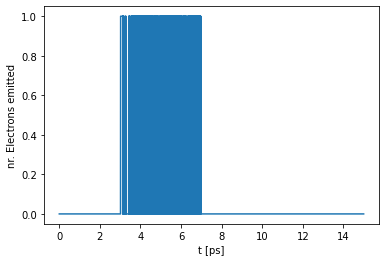

In [67]:
print(data.shape)
plt.plot(t, signal)
plt.xlabel('t [ps]')
plt.ylabel('nr. Electrons emitted')
plt.show()

In [68]:
time_step = (t[1] - t[0])*time_scale

FFT = abs(fft(signal))
freqs = scipy.fft.fftfreq(signal.size, time_step)
N = len(freqs)
Nh = int(N/2)

Text(0.5, 0, 'f [THz]')

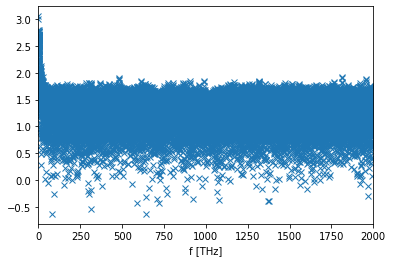

In [69]:
plt.plot(freqs[:Nh]/1.0E12, np.lib.scimath.log10(FFT[:Nh]), 'x')
plt.xlim([0, 2000])
plt.xlabel('f [THz]')

In [70]:
max_f = freqs[np.argmax(FFT[1:Nh])]
print('Frequency ', max_f/1.0E12, ' THz')

Frequency  0.0  THz


Frequency  0.0  THz
Frequency  0.0  THz
Frequency  0.0  THz
Frequency  0.0  THz
Frequency  0.0  THz
Frequency  0.0  THz
Frequency  0.0  THz
Frequency  0.0  THz
Frequency  0.0  THz
Frequency  0.0  THz
Frequency  0.0  THz
/home/hakon/.local/lib/python3.8/site-packages/numpy/lib/scimath.py:338: RuntimeWarning: divide by zero encountered in log10
  return nx.log10(x)
Frequency  0.0  THz
Frequency  0.0  THz
Frequency  0.0  THz


Text(0.5, 0, 'f [THz]')

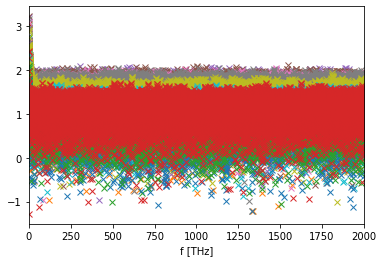

In [73]:
import glob
from pathlib import Path

p = Path('/home/hakon/Desktop/PE Simulations/')
for name in p.glob('**/*On*/data/out/emitted.dt'):
    # Loading in one batch of sim.
    data = np.loadtxt(name, usecols=(0,2))
    t = data[1:, 0]
    signal = data[1:, 1]
    time_step = (t[1] - t[0])*time_scale
    FFT = abs(fft(signal))
    freqs = scipy.fft.fftfreq(signal.size, time_step)
    N = len(freqs)
    Nh = int(N/2)
    plt.plot(freqs[:Nh]/1.0E12, np.lib.scimath.log10(FFT[:Nh]), 'x')
    max_f = freqs[np.argmax(FFT[1:Nh])]
    print('Frequency ', max_f/1.0E12, ' THz')

plt.xlim([0, 2000])
plt.xlabel('f [THz]')